# Assignment - 4

# 2022121008

# Prakhar Jain

**Conext**

**Cityscapes data** contains labeled videos taken from vehicles driven in Germany. This version is a processed subsample created as part of the [Pix2Pix](https://phillipi.github.io/pix2pix/) paper. The dataset has still images from the original videos, and the semantic segmentation labels are shown in images alongside the original image. This is one of the best datasets around for semantic segmentation tasks.

**Content**

This dataset has 2975 training images files and 500 validation image files. Each image file is 256x512 pixels, and each file is a composite with the original photo on the left half of the image, alongside the labeled image (output of semantic segmentation) on the right half.

**Dataset:** 

https://www.kaggle.com/dansbecker/cityscapes-image-pairs

**References:** 

*   https://arxiv.org/pdf/1603.07285v1.pdf
*   https://towardsdatascience.com/u-net-b229b32b4a71



# Q1: Segmentation [4 points]

### 1. [1 point] Preparation. 
We will use an existing illustrative code for segmentation using a Unet in Pytorch.


Please make a copy of the following notebook as a google colab project and ensure you are able to run it:

`https://www.kaggle.com/code/dhvananrangrej/image-segmentation-with-unet-pytorch/notebook`

The first cell should contain the necessary code to download the segmentation dataset (a subset of Cityscapes).

Carefully study the code, especially focusing on the data and model.

Do not change the model definition, dataset class, or evaluation metric (currently being computed over 10 images
or 1 batch of the validation set). You may need to fix one bug `iter(data_loader).next()`, but this does not influence the other parts.

Hint: You may train the model for 1 epoch as it takes quite some time to complete all 10 epochs.

In [79]:

import os
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

from pathlib import Path

from tqdm.auto import tqdm

In [80]:
device = "cuda:0" if torch.cuda.is_available() else "cpu"
device = torch.device(device)
print(device)

cuda:0


### 2. Configure data locations

In [81]:
data_dir = Path("cityscapes_data")
train_dir = data_dir / "train"
val_dir = data_dir / "val"


# data_dir = os.path.join("/kaggle", "input", "cityscapes-image-pairs", "cityscapes_data")
# train_dir = os.path.join(data_dir, "train") 
# val_dir = os.path.join(data_dir, "val")


train_fns = os.listdir(train_dir)
val_fns = os.listdir(val_dir)

print(len(train_fns), len(val_fns))
# print(f"Train Directory : {train_dir}")
# print(f"Validation Directory : {val_dir}")

2975 500


### 3. Analyze data

cityscapes_data/train/936.jpg


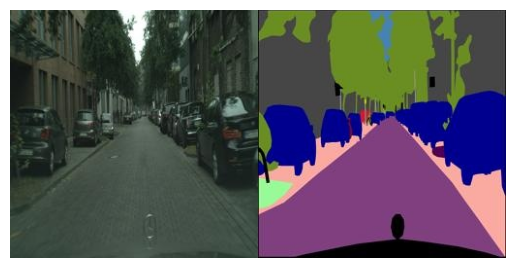

In [82]:
# sample_image_fp = os.path.join(train_dir, train_fns[0])
sample_image_fp = train_dir / train_fns[0]


sample_image = Image.open(sample_image_fp).convert("RGB")

plt.imshow(sample_image)
plt.axis("off")

print(sample_image_fp)

### 4. Extract Image and Labels

The input images contain both the road scene and the corresponding label in the same image. Thus, we are splitting it and presenting it as two separate entities.

In [83]:
def split_image(image):
  image = np.array(image)
  # print(image.shape)
  cityscape, label = image[:, :256, :], image[:, 256:, :]
  return cityscape, label

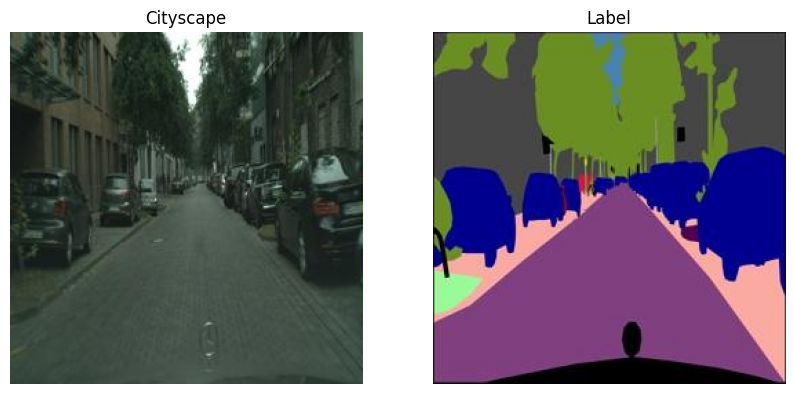

In [84]:
sample_image = np.array(sample_image)
cityscape, label = split_image(sample_image)

# display split images
cityscape, label = Image.fromarray(cityscape), Image.fromarray(label)
fig, axes = plt.subplots(1, 2, figsize=(10,5))
axes[0].imshow(cityscape)
axes[0].axis("off")
axes[0].set_title("Cityscape")
axes[1].imshow(label)
axes[1].axis("off")
axes[1].set_title("Label")
plt.show()

### 5. Define Labels

We use K-means clustering to segregate the objects of different colors and assign them class labels.   

In [85]:
num_items = 1000
color_array = np.random.choice(range(256), 3*num_items).reshape(-1,3)
print(color_array.shape)

(1000, 3)


In [86]:
num_classes = 10
label_model = KMeans(n_clusters = num_classes)
label_model.fit(color_array)

KMeans(n_clusters=10)

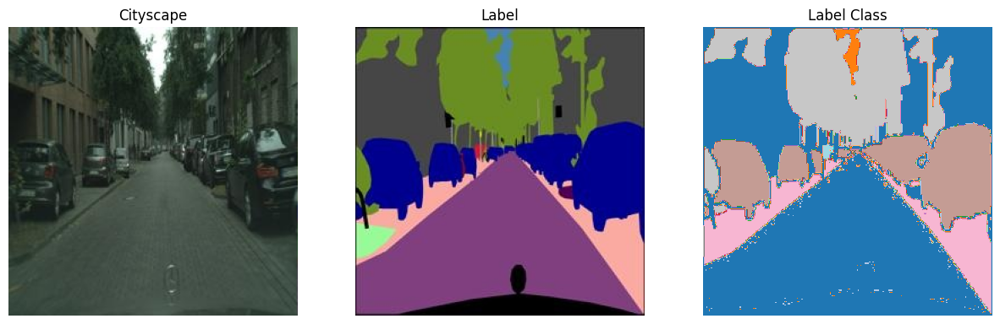

In [87]:
cityscape, label = split_image(sample_image)
label_class = label_model.predict(label.reshape(-1,3)).reshape(256,256)
fig, axes = plt.subplots(1,3,figsize=(15,5))
# plt.axis('off')
axes[0].imshow(cityscape)
axes[0].set_title('Cityscape')
axes[0].axis('off')
axes[1].imshow(label)
axes[1].set_title('Label')
axes[1].axis('off')
axes[2].imshow(label_class, cmap='tab20', vmin=0, vmax=num_classes-1)
axes[2].set_title('Label Class')
axes[2].axis('off')
plt.show()

In [88]:
# label_class

### 6. Define Dataset

In [89]:
class CityscapeDataset(Dataset):

  def __init__(self, image_dir, label_model):
    self.image_dir = image_dir
    self.image_fns = os.listdir(image_dir)
    self.label_model = label_model

  def __len__(self):
    return len(self.image_fns)
  
  def __getitem__(self, index):
    image_fn = self.image_fns[index]
    image_fp = os.path.join(self.image_dir, image_fn)
    image = Image.open(image_fp).convert("RGB")
    image = np.array(image)
    cityscape, label = self.split_image(image)
    label_class = self.label_model.predict(label.reshape(-1,3)).reshape(256,256)
    label_class = torch.Tensor(label_class).long()
    cityscape = self.transform(cityscape)
    return cityscape, label_class

  def split_image(self, image):
    image = np.array(image)
    cityscape, label = image[:, :256, :], image[:, 256:, :]
    return cityscape, label
  
  def transform(self, image):
    transform_ops = transforms.Compose([
                                        transforms.ToTensor(),
                                        transforms.Normalize(mean=(0.485, 0.56, 0.406), std=(0.229, 0.224, 0.225))
    ])
    return transform_ops(image)

In [90]:
dataset = CityscapeDataset(train_dir, label_model)
print(len(dataset))

2975


In [91]:
cityscape, label_class= dataset[0]
print(cityscape.shape, label_class.shape)

torch.Size([3, 256, 256]) torch.Size([256, 256])


### 7. Define Model 


In [92]:
class UNet(nn.Module):
    
    def __init__(self, num_classes):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        self.contracting_11 = self.conv_block(in_channels=3, out_channels=64)
        self.contracting_12 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_21 = self.conv_block(in_channels=64, out_channels=128)
        self.contracting_22 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_31 = self.conv_block(in_channels=128, out_channels=256)
        self.contracting_32 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_41 = self.conv_block(in_channels=256, out_channels=512)
        self.contracting_42 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.middle = self.conv_block(in_channels=512, out_channels=1024)
        self.expansive_11 = nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_12 = self.conv_block(in_channels=1024, out_channels=512)
        self.expansive_21 = nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_22 = self.conv_block(in_channels=512, out_channels=256)
        self.expansive_31 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_32 = self.conv_block(in_channels=256, out_channels=128)
        self.expansive_41 = nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_42 = self.conv_block(in_channels=128, out_channels=64)
        self.output = nn.Conv2d(in_channels=64, out_channels=num_classes, kernel_size=3, stride=1, padding=1)
        
    def conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels),
                                    nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def forward(self, X):
        contracting_11_out = self.contracting_11(X) # [-1, 64, 256, 256]
        contracting_12_out = self.contracting_12(contracting_11_out) # [-1, 64, 128, 128]
        contracting_21_out = self.contracting_21(contracting_12_out) # [-1, 128, 128, 128]
        contracting_22_out = self.contracting_22(contracting_21_out) # [-1, 128, 64, 64]
        contracting_31_out = self.contracting_31(contracting_22_out) # [-1, 256, 64, 64]
        contracting_32_out = self.contracting_32(contracting_31_out) # [-1, 256, 32, 32]
        contracting_41_out = self.contracting_41(contracting_32_out) # [-1, 512, 32, 32]
        contracting_42_out = self.contracting_42(contracting_41_out) # [-1, 512, 16, 16]
        middle_out = self.middle(contracting_42_out) # [-1, 1024, 16, 16]
        expansive_11_out = self.expansive_11(middle_out) # [-1, 512, 32, 32]
        expansive_12_out = self.expansive_12(torch.cat((expansive_11_out, contracting_41_out), dim=1)) # [-1, 1024, 32, 32] -> [-1, 512, 32, 32]
        expansive_21_out = self.expansive_21(expansive_12_out) # [-1, 256, 64, 64]
        expansive_22_out = self.expansive_22(torch.cat((expansive_21_out, contracting_31_out), dim=1)) # [-1, 512, 64, 64] -> [-1, 256, 64, 64]
        expansive_31_out = self.expansive_31(expansive_22_out) # [-1, 128, 128, 128]
        expansive_32_out = self.expansive_32(torch.cat((expansive_31_out, contracting_21_out), dim=1)) # [-1, 256, 128, 128] -> [-1, 128, 128, 128]
        expansive_41_out = self.expansive_41(expansive_32_out) # [-1, 64, 256, 256]
        expansive_42_out = self.expansive_42(torch.cat((expansive_41_out, contracting_11_out), dim=1)) # [-1, 128, 256, 256] -> [-1, 64, 256, 256]
        output_out = self.output(expansive_42_out) # [-1, num_classes, 256, 256]
        return output_out

In [93]:
model = UNet(num_classes = num_classes)

In [94]:
data_loader = DataLoader(dataset, batch_size = 4)
print(len(dataset), len(data_loader))

data_iter = iter(data_loader)
X, Y = next(data_iter)
print(X.shape, Y.shape)

2975 744

torch.Size([4, 3, 256, 256]) torch.Size([4, 256, 256])


In [95]:
Y_pred = model(X)
print(Y_pred.shape)

torch.Size([4, 10, 256, 256])


### 8. Train the model

In [96]:
# def compute_iou(pred, true):
#     unique_labels = np.unique(true)
#     iou_list = []
#     for cls in unique_labels:
#         pred_idx = (pred == cls)
#         true_idx = (true == cls)
#         intersection = np.logical_and(pred_idx, true_idx).sum()
#         union = np.logical_or(pred_idx, true_idx).sum()

#         if union == 0:
#             if intersection == 0:
#                 iou_list.append(1)
#         else : 
#             iou_list.append(intersection / union)
#     return np.nanmean(iou_list)


# to account for class imbalance
def compute_iou(pred, true):
    # print(len(pred), len(true))
    unique_labels, counts = np.unique(true, return_counts=True)
    total_counts = np.sum(counts)
    # print("True :")
    # for label, count in zip(unique_labels, counts):
    #     print(f"Label: {label}, Count: {count}")
    # unique_labels_predicted, counts_predicted = np.unique(pred, return_counts=True)
    # print("True :")
    # for label, count in zip(unique_labels_predicted, counts_predicted):
    #     print(f"Label: {label}, Count: {count}")
    
    
    iou_list = []
    for cls, count in zip(unique_labels, counts):
        pred_idx = (pred == cls)
        true_idx = (true == cls)
        intersection = np.logical_and(pred_idx, true_idx).sum()
        union = np.logical_or(pred_idx, true_idx).sum()
        # print(f"{cls} | Intersection : {intersection} | Union : {union} | Count : {count} | Total Counts : {total_counts}")

        if union == 0:
            if intersection == 0:
                iou_list.append(1)
        else : 
            iou_list.append(intersection / union)
    return np.nanmean(iou_list)
    
def compute_iou_for_batch(pred, true):
    iou_for_each_image = []
    for pre, tru in zip(pred, true):
        unique_labels, counts = np.unique(tru, return_counts=True)
        total_counts = np.sum(counts)
        
        iou_list = []
        for cls, count in zip(unique_labels, counts):
            pred_idx = (pre == cls)
            true_idx = (tru == cls)
            intersection = np.logical_and(pred_idx, true_idx).sum()
            union = np.logical_or(pred_idx, true_idx).sum()
            # print(f"{cls} | Intersection : {intersection} | Union : {union} | Count : {count} | Total Counts : {total_counts}")

            if union == 0:
                if intersection == 0:
                    iou_list.append(1)
            else:
                iou_list.append(intersection / union)
        
        iou_for_each_image.append(np.nanmean(iou_list))
    
    return iou_for_each_image

                

In [97]:
batch_size = 16

epochs = 10
lr = 0.01

In [98]:
dataset = CityscapeDataset(train_dir, label_model)
data_loader = DataLoader(dataset, batch_size = batch_size)

# model here

model = UNet(num_classes = num_classes).to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = lr)

step_losses = []
epoch_losses = []
ious = []

for epoch in tqdm(range(epochs)):
  epoch_loss = 0
  epoch_iou = []
  for X,Y in tqdm(data_loader, total=len(data_loader), leave = False):
    X, Y = X.to(device), Y.to(device)
    # print(X.shape[0], Y.shape[0])
    optimizer.zero_grad()
    Y_pred = model(X)
    loss = criterion(Y_pred, Y)
    loss.backward()
    optimizer.step()
    epoch_loss += loss.item()
    step_losses.append(loss.item())

    # Calculate IoU
    Y_pred_argmax = torch.argmax(Y_pred, dim=1)
    # iou is a list here
    iou = compute_iou_for_batch(Y_pred_argmax.cpu().numpy(), Y.cpu().numpy())
    epoch_iou += iou
  ious.append(epoch_iou)

  epoch_losses.append(epoch_loss/len(data_loader))


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

In [99]:
len(ious[-1])

2975

In [100]:
print(ious[-1])

[0.33934816256096695, 0.33395145011806027, 0.4034044128875767, 0.4643279051591313, 0.37135922872807425, 0.4293487604565108, 0.44833064366104364, 0.39005254213336144, 0.3148649869504906, 0.44378733371768897, 0.40011616814603196, 0.3580997450034139, 0.37332718055443376, 0.277700177758725, 0.44007070689950045, 0.4335086654748325, 0.4101728902500023, 0.41466551990229594, 0.27892077035066504, 0.29110024333424134, 0.39711967297699813, 0.4146909363571014, 0.46595816047084715, 0.3821885429982656, 0.42661534010645286, 0.2804604206743215, 0.3481246921267548, 0.4198988156657273, 0.35123316008548316, 0.34314406212198845, 0.3404897263971727, 0.3465384906380055, 0.3344454839179991, 0.39921547427927845, 0.31076389359378537, 0.2814038711149259, 0.27182311148273186, 0.4250685783188701, 0.49589194479473464, 0.5315021101944726, 0.426054557594558, 0.3125120848202969, 0.40364287797869686, 0.4301012319649565, 0.4003845876308719, 0.41493825808710166, 0.33913583558332316, 0.2925292691024854, 0.379090321241147

In [101]:
# dump step_losses and epoch_losses to a npy file
np.save("step_losses.npy", np.array(step_losses))
np.save("epoch_losses.npy", np.array(epoch_losses))


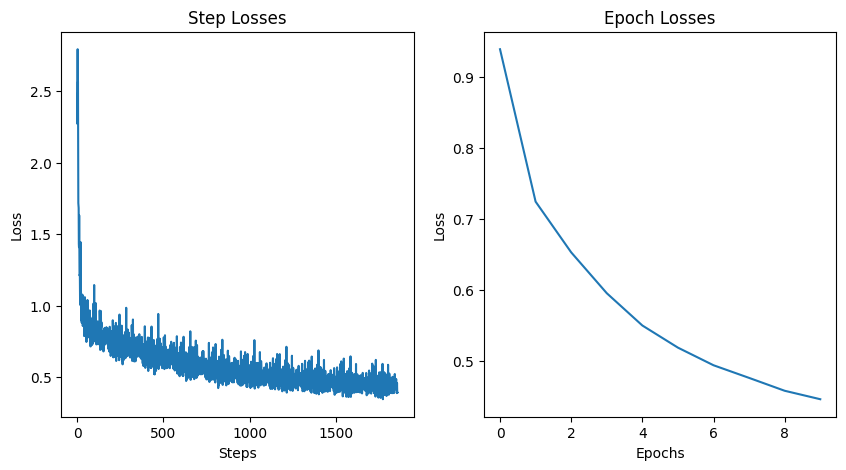

In [102]:
fig, axes = plt.subplots(1,2, figsize=(10,5))
axes[0].plot(step_losses)
axes[0].set_xlabel("Steps")
axes[0].set_ylabel("Loss")
axes[0].set_title("Step Losses")
axes[1].set_xlabel("Epochs")
axes[1].set_ylabel("Loss")
axes[1].set_title("Epoch Losses")
axes[1].plot(epoch_losses)
plt.show()

In [103]:
model_name = "U-Net.pth"
torch.save(model.state_dict(), model_name)

### 9. Check model predictions

In [104]:
model_path = "U-Net.pth"
model_ = UNet(num_classes=num_classes).to(device)
model_.load_state_dict(torch.load(model_path))

<All keys matched successfully>

In [105]:
test_batch_size = 10
dataset = CityscapeDataset(val_dir, label_model)
data_loader = DataLoader(dataset, batch_size=test_batch_size)

In [106]:
X,Y = next(iter(data_loader))
X,Y = X.to(device), Y.to(device)
Y_pred = model_(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

torch.Size([10, 10, 256, 256])

torch.Size([10, 256, 256])


In [107]:
inverse_transform = transforms.Compose([
    transforms.Normalize((-0.485/0.229, -0.456/0.224, -0.406/0.225), (1/0.229, 1/0.224, 1/0.225))
])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

C

Image : 0 | Mean IOU : 0.3017770365555538

Image : 1 | Mean IOU : 0.5245350384822509

Image : 2 | Mean IOU : 0.36552415877274935

Image : 3 | Mean IOU : 0.39147711859733497

Image : 4 | Mean IOU : 0.2070398978981802

Image : 5 | Mean IOU : 0.4294758955295529

Image : 6 | Mean IOU : 0.4597364966292182

Image : 7 | Mean IOU : 0.38033208152768544

Image : 8 | Mean IOU : 0.3596295563973933

Image : 9 | Mean IOU : 0.27861158832701527


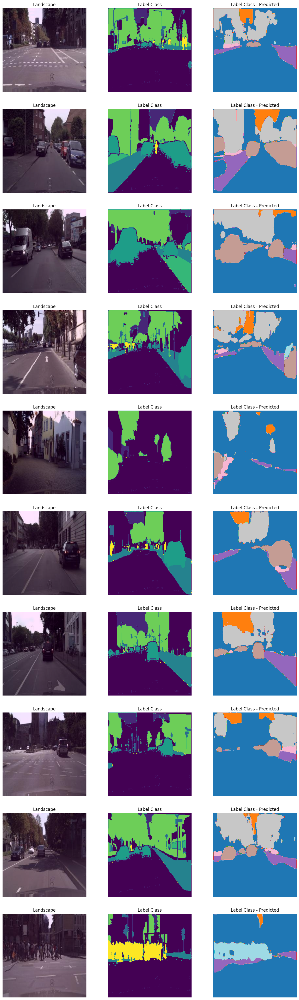

In [108]:
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

iou_scores = []

for i in range(test_batch_size):
    
    landscape = inverse_transform(X[i]).permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()
    
    
    # print(f'{i} | Mean IoU: {compute_iou(label_class_predicted, label_class, num_classes)}')
    # iou_score = compute_iou(label_class_predicted, label_class, num_classes)
    iou_score = compute_iou(label_class_predicted, label_class)
    print(f"Image : {i} | Mean IOU : {iou_score}")
    iou_scores.append(iou_score)
    # IOU score
    # intersection = np.logical_and(label_class, label_class_predicted)
    # union = np.logical_or(label_class, label_class_predicted)
    # iou_score = np.sum(intersection) / np.sum(union)
    # iou_scores.append(iou_score)

    axes[i, 0].imshow(landscape)
    axes[i, 0].axis('off')
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].axis('off')
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted, cmap='tab20', vmin=0, vmax=num_classes-1)
    axes[i, 2].axis('off')
    axes[i, 2].set_title("Label Class - Predicted")


In [109]:
print(f"Mean IOU Score : {np.mean(iou_scores)}")

Mean IOU Score : 0.3698138868716935


# Without skip connections

In [110]:
class UNetNoSkipConnections(nn.Module):
    
    def __init__(self, num_classes):
        super(UNetNoSkipConnections, self).__init__()
        self.num_classes = num_classes
        self.contracting_11 = self.conv_block(in_channels=3, out_channels=64)
        self.contracting_12 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_21 = self.conv_block(in_channels=64, out_channels=128)
        self.contracting_22 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_31 = self.conv_block(in_channels=128, out_channels=256)
        self.contracting_32 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_41 = self.conv_block(in_channels=256, out_channels=512)
        self.contracting_42 = nn.MaxPool2d(kernel_size=2, stride=2)
        
        self.middle = self.conv_block(in_channels=512, out_channels=1024)
        
        self.expansive_11 = nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=3, stride=2, padding=1, output_padding=1)
        # self.expansive_12 = self.conv_block(in_channels=1024, out_channels=512)
        self.expansive_12 = self.conv_block(in_channels=512, out_channels=512)
        
        self.expansive_21 = nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=3, stride=2, padding=1, output_padding=1)
        # self.expansive_22 = self.conv_block(in_channels=512, out_channels=256)
        self.expansive_22 = self.conv_block(in_channels=256, out_channels=256)
        self.expansive_31 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1)
        # self.expansive_32 = self.conv_block(in_channels=256, out_channels=128)
        self.expansive_32 = self.conv_block(in_channels=128, out_channels=128)
        self.expansive_41 = nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1)
        # self.expansive_42 = self.conv_block(in_channels=128, out_channels=64)
        self.expansive_42 = self.conv_block(in_channels=64, out_channels=64)
        self.output = nn.Conv2d(in_channels=64, out_channels=num_classes, kernel_size=3, stride=1, padding=1)
        
    def conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels),
                                    nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def forward(self, X):
        contracting_11_out = self.contracting_11(X) # [-1, 64, 256, 256]
        contracting_12_out = self.contracting_12(contracting_11_out) # [-1, 64, 128, 128]
        contracting_21_out = self.contracting_21(contracting_12_out) # [-1, 128, 128, 128]
        contracting_22_out = self.contracting_22(contracting_21_out) # [-1, 128, 64, 64]
        contracting_31_out = self.contracting_31(contracting_22_out) # [-1, 256, 64, 64]
        contracting_32_out = self.contracting_32(contracting_31_out) # [-1, 256, 32, 32]
        contracting_41_out = self.contracting_41(contracting_32_out) # [-1, 512, 32, 32]
        contracting_42_out = self.contracting_42(contracting_41_out) # [-1, 512, 16, 16]
        
        middle_out = self.middle(contracting_42_out) # [-1, 1024, 16, 16]
        
        expansive_11_out = self.expansive_11(middle_out) # [-1, 512, 32, 32]
        expansive_12_out = self.expansive_12(expansive_11_out) # [-1, 512, 32, 32] -> [-1, 512, 32, 32]
        expansive_21_out = self.expansive_21(expansive_12_out) # [-1, 256, 64, 64]
        expansive_22_out = self.expansive_22(expansive_21_out) # [-1, 256, 64, 64] -> [-1, 256, 64, 64]
        expansive_31_out = self.expansive_31(expansive_22_out) # [-1, 128, 128, 128]
        expansive_32_out = self.expansive_32(expansive_31_out) # [-1, 128, 128, 128] -> [-1, 128, 128, 128]
        expansive_41_out = self.expansive_41(expansive_32_out) # [-1, 64, 256, 256]
        expansive_42_out = self.expansive_42(expansive_41_out) # [-1, 64, 256, 256] -> [-1, 64, 256, 256]
        output_out = self.output(expansive_42_out) # [-1, num_classes, 256, 256]
        return output_out

In [111]:
batch_size = 16

epochs = 10
lr = 0.01

In [112]:
dataset = CityscapeDataset(train_dir, label_model)
data_loader = DataLoader(dataset, batch_size = batch_size)

In [113]:
model = UNetNoSkipConnections(num_classes = num_classes).to(device)

In [114]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = lr)

In [115]:

step_losses = []
epoch_losses = []
ious = []

for epoch in tqdm(range(epochs)):
  epoch_loss = 0
  epoch_iou = []
  for X,Y in tqdm(data_loader, total=len(data_loader), leave = False):
    X, Y = X.to(device), Y.to(device)
    # print(X.shape[0], Y.shape[0])
    optimizer.zero_grad()
    Y_pred = model(X)
    loss = criterion(Y_pred, Y)
    loss.backward()
    optimizer.step()
    epoch_loss += loss.item()
    step_losses.append(loss.item())

    # Calculate IoU
    Y_pred_argmax = torch.argmax(Y_pred, dim=1)
    # iou is a list here
    iou = compute_iou_for_batch(Y_pred_argmax.cpu().numpy(), Y.cpu().numpy())
    epoch_iou += iou
  ious.append(epoch_iou)

  epoch_losses.append(epoch_loss/len(data_loader))


  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

  0%|          | 0/186 [00:00<?, ?it/s]

In [116]:
len(ious[-1])

2975

In [117]:
print(ious[-1])

[0.3126252095531194, 0.30235712453760666, 0.38189981367261905, 0.4488734591328206, 0.3668967548362015, 0.38294072297604687, 0.4344721015589295, 0.379177836529146, 0.2709217512773753, 0.35604417687038314, 0.37985346419271293, 0.34000737560864214, 0.386695673340886, 0.24960415512752737, 0.3895020530911999, 0.4002771976989576, 0.38589349523786615, 0.4029990214667213, 0.25889356006570413, 0.28365366085986915, 0.3848425609508846, 0.3606697685152901, 0.3948926249787593, 0.3143329204831472, 0.43080944673700705, 0.2576705561889104, 0.3466864960995278, 0.39275615553404875, 0.3263267523704561, 0.30693154290428243, 0.3297669451560824, 0.3633056768321265, 0.30322263578331166, 0.37472095182871823, 0.2894511912195437, 0.2546141865695296, 0.24086610211829146, 0.4118043659591691, 0.4273816296712595, 0.50835557935996, 0.3919954096587463, 0.3004035768732063, 0.3603493247585146, 0.40215954715671054, 0.3600280689191313, 0.3501274179632282, 0.31996673425471106, 0.25890021516246037, 0.3354265837542926, 0.23

In [118]:
# dump step_losses and epoch_losses to a npy file
np.save("step_losses_no_skip_connections.npy", np.array(step_losses))
np.save("epoch_losses_no_skip_connections.npy", np.array(epoch_losses))


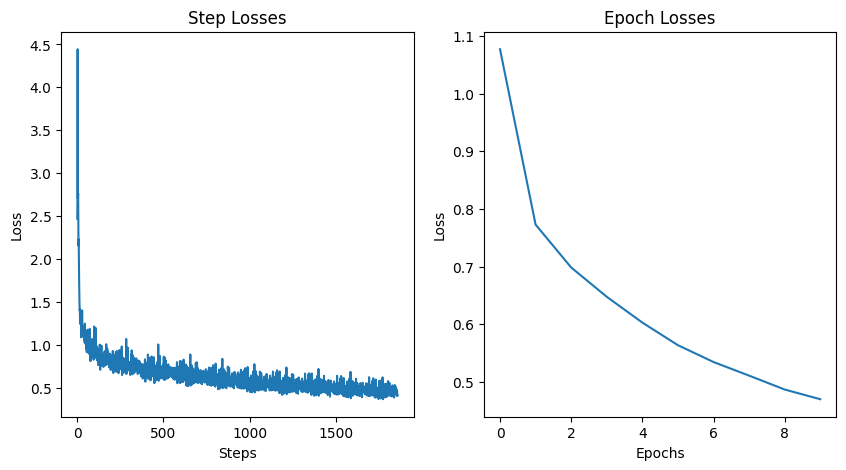

In [119]:
fig, axes = plt.subplots(1,2, figsize=(10,5))
axes[0].plot(step_losses)
axes[0].set_xlabel("Steps")
axes[0].set_ylabel("Loss")
axes[0].set_title("Step Losses")
axes[1].set_xlabel("Epochs")
axes[1].set_ylabel("Loss")
axes[1].set_title("Epoch Losses")
axes[1].plot(epoch_losses)
plt.show()

In [120]:
model_name = "U-Net-no-skip-connection.pth"
torch.save(model.state_dict(), model_name)

In [121]:
model_path = "U-Net-no-skip-connection.pth"
model_ = UNetNoSkipConnections(num_classes=num_classes).to(device)
model_.load_state_dict(torch.load(model_path))

<All keys matched successfully>

In [122]:
test_batch_size = 10
dataset = CityscapeDataset(val_dir, label_model)
data_loader = DataLoader(dataset, batch_size=test_batch_size)

In [123]:
X,Y = next(iter(data_loader))
X,Y = X.to(device), Y.to(device)
Y_pred = model_(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

torch.Size([10, 10, 256, 256])

torch.Size([10, 256, 256])


In [124]:
inverse_transform = transforms.Compose([
    transforms.Normalize((-0.485/0.229, -0.456/0.224, -0.406/0.225), (1/0.229, 1/0.224, 1/0.225))
])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

C

Image : 0 | Mean IOU : 0.25409668736167923

Image : 1 | Mean IOU : 0.4985211393914122

Image : 2 | Mean IOU : 0.36060948224614303

Image : 3 | Mean IOU : 0.36099887522613106

Image : 4 | Mean IOU : 0.22910814908892316

Image : 5 | Mean IOU : 0.4115463973726523

Image : 6 | Mean IOU : 0.44416786470793695

Image : 7 | Mean IOU : 0.3418332063620143

Image : 8 | Mean IOU : 0.3525912073013452

Image : 9 | Mean IOU : 0.1810178900808252


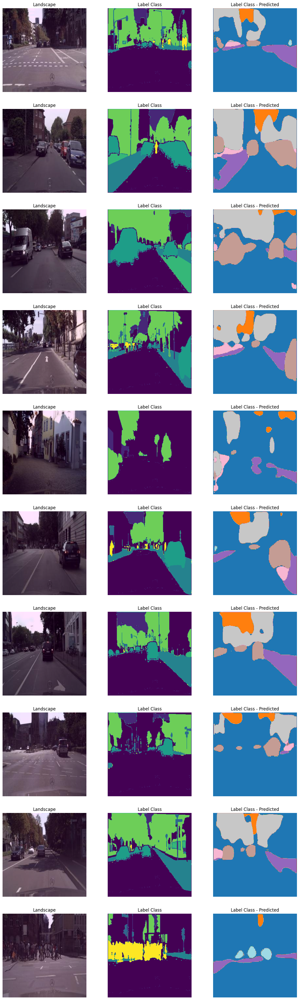

In [125]:
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

iou_scores = []

for i in range(test_batch_size):
    
    landscape = inverse_transform(X[i]).permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()
    
    iou_score = compute_iou(label_class_predicted, label_class)
    print(f"Image : {i} | Mean IOU : {iou_score}")
    iou_scores.append(iou_score)
    
    # IOU score
    # intersection = np.logical_and(label_class, label_class_predicted)
    # union = np.logical_or(label_class, label_class_predicted)
    # iou_score = np.sum(intersection) / np.sum(union)
    # iou_scores.append(iou_score)

    axes[i, 0].imshow(landscape)
    axes[i, 0].axis('off')
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].axis('off')
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted, cmap='tab20', vmin=0, vmax=num_classes-1)
    axes[i, 2].axis('off')
    axes[i, 2].set_title("Label Class - Predicted")

In [126]:
print(f"Mean IOU Score : {np.mean(iou_scores)}")

Mean IOU Score : 0.34344908991390627


### 2. [2 points] Importance of skip connections

The above model is a standard Unet architecture. The key
novelty in the Unet are the skip connections between the encoder and decoder. But how important are they?
In this experiment, modify the model to disconnect the skip connections. As compared to the original model,
does the new model perform well? Report the results, both qualitatively and quantitatively (IoU over the same
10 images as before).

**Hint 1:** When removing the skip connections, you will need to halve the number of input channels too.

**Hint 2:** For a fair comparison to the above model, please train the new model without skip connections for the
same number of epochs (1 if you followed the above point!).


- With connections (original model), the IoU for validation is 0.3698.
- Without connections (modified model), the IoU for validation is 0.3434.

This indicates that the skip connections are indeed important for the performance of the model, providing a qualitative improvement in the segmentation results.

The model with skip connections is able to capture the fine details in the segmentation masks. The model without skip connections is not able to capture the fine details and the boundaries are very smooth.

### 3. [1 point] Metric
The metric implemented in the notebook calculates IoU directly (`logical_and` and `logical_or`)
and does not seem correct.
First, explain what is the issue with the metric in the current form.
Next, re-write the metric function to instead compute an IoU for each class. Report the mean over all classes as
the score for each image, and the mean over all images as the score for the validation set (or 10 images therein).
Is the mIoU score different between the model with and without skip connections? Explain why

### Answer

The issue with the current implementation of the IoU metric is that it calculates IoU directly without considering individual classes. IoU (Intersection over Union) measures the overlap between the predicted and ground truth bounding boxes or segmentation masks. However, in its current form, the metric doesn't distinguish between different classes in the segmentation task. It simply computes the IoU score considering all classes collectively, which might not accurately reflect the performance of the model on each individual class. We modified the metric function to compute IoU for each class separately.

The metric function was already rewritten previously. Yes, the mean Intersection over Union (mIoU) score is different between the models with and without skip connections based on the scores.

- The mIoU score has decreased when skip connections were removed, which suggests that the model without skip connections performs worse in terms of accurately segmenting the various classes in the images. 

- Skip connections allow the network to reuse features from earlier layers directly in deeper layers. This means that detailed spatial information that could be lost during downsampling is retained, improving the quality of the segmentation.

- In segmentation tasks, combining the high-level contextual information (which determines what the object is) with low-level details (which determine the exact boundaries of objects) is crucial. Skip connections effectively provide a shortcut for this combination.

# Q2: Contrastive Language-Image Pretraining [6 points]

In [1]:
pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-cdmqa7v0
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-cdmqa7v0
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 799.5 kB/s eta 0:00:000:00:01
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369497 sha256=ccfb23110b7b7b16278e1318a7e8bfba644f4586764ca76a8b2d19b4bfb41e01
  Stored in directory: /tmp/pip-ephem-wheel-cache-jlaif496/wheels/da/2b/4c/d6691fa9597aac8bb85d2ac13b112deb897d5b50f5ad9a37e4
Successfully built clip
Note: you may need to restart the kernel to use updated packages.


In [2]:

import os
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
# from sklearn.cluster import KMeans
import clip
import cv2

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.models import resnet50, ResNet50_Weights

from pathlib import Path

from tqdm.auto import tqdm


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [3]:
weights = ResNet50_Weights.IMAGENET1K_V1
torch_model = resnet50(weights=weights).to(device)
preprocess_resnet = weights.transforms()


Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 148MB/s] 


In [4]:
clip.available_models()

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

In [5]:
help(clip.load)

Help on function load in module clip.clip:

load(name: str, device: Union[str, torch.device] = 'cuda', jit: bool = False, download_root: str = None)
    Load a CLIP model
    
    Parameters
    ----------
    name : str
        A model name listed by `clip.available_models()`, or the path to a model checkpoint containing the state_dict
    
    device : Union[str, torch.device]
        The device to put the loaded model
    
    jit : bool
        Whether to load the optimized JIT model or more hackable non-JIT model (default).
    
    download_root: str
        path to download the model files; by default, it uses "~/.cache/clip"
    
    Returns
    -------
    model : torch.nn.Module
        The CLIP model
    
    preprocess : Callable[[PIL.Image], torch.Tensor]
        A torchvision transform that converts a PIL image into a tensor that the returned model can take as its input



In [6]:
clip_model, preprocess = clip.load('RN50', device = device)

100%|████████████████████████████████████████| 244M/244M [00:02<00:00, 123MiB/s]


In [7]:
clip_model

CLIP(
  (visual): ModifiedResNet(
    (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu1): ReLU(inplace=True)
    (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu2): ReLU(inplace=True)
    (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu3): ReLU(inplace=True)
    (avgpool): AvgPool2d(kernel_size=2, stride=2, padding=0)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
     

## 2.1 Setup models. 

Load the ResNet-50 (RN50) model, initialized in two different ways:

(a) ImageNet pretraining (torchvision.models can be used, specifically look at IMAGENET1K_V1); and

(b) OpenAI’s CLIP (see https://github.com/openai/CLIP).

Do the visual encoders have the same architecture? If not, please describe and explain the differences.

Hint: When you load the CLIP model, you will get both the vision and text encoders - be sure to differentiate between them as necessary.


## Answer
No, the visual encoders in the ResNet and CLIP models have different architectures. Here are the key differences:

1. **Overall Structure**: The ResNet model follows the traditional ResNet architecture with stacked residual blocks and increasing channel depths. The CLIP visual encoder is based on a modified ResNet architecture with some changes, such as the use of average pooling instead of stride convolutions for downsampling.

2. **Convolutions**: The ResNet model starts with a single 7x7 convolution with a stride of 2, followed by batch normalization and ReLU activation. The CLIP visual encoder starts with three consecutive 3x3 convolutions, each followed by batch normalization and ReLU activation.

3. **Downsampling**: In the ResNet model, downsampling is performed using stride convolutions in the first block of each stage. In the CLIP visual encoder, downsampling is achieved using average pooling layers instead of stride convolutions.

4. **Bottleneck Blocks**: The ResNet model uses the traditional bottleneck block structure with 1x1, 3x3, and 1x1 convolutions. The CLIP visual encoder uses a modified bottleneck block structure that replaces the 1x1 convolution with an average pooling layer in some cases.

5. **Attention Pooling**: The CLIP visual encoder incorporates an AttentionPool2d module before the transformer, which performs spatial attention pooling over the final feature maps. This module is absent in the traditional ResNet model.

6. **Output Dimensionality**: The ResNet model outputs a +1000-dimensional vector for image classification. The CLIP visual encoder outputs a 1024-dimensional vector, which is then processed by the transformer for the multimodal task.

The architectural differences between the ResNet and CLIP visual encoders are primarily driven by their intended use cases. The ResNet model is designed for image classification, while the CLIP visual encoder is tailored for multimodal tasks that involve both image and text data. The CLIP visual encoder incorporates modifications to the ResNet architecture, such as attention pooling, to better capture and integrate visual information with the textual representation learned by the transformer.

## 2.2 Setup data. 

Understand the ImageNet challenge dataset (1000 labels of ILSVRC).

1. **What label hierarchy is used in ImageNet?**

    ImageNet uses the WordNet hierarchy, which is a hierarchical structure of nouns organized into sets of synonyms called synsets. For example, the synset for "dog" includes "domestic dog" and "Canis familiaris". The ImageNet dataset is based on the WordNet noun hierarchy, where each synset represents a distinct concept or object category.

2. **What does a synset mean?**

    A synset (short for "synonym set") is a group of words or phrases that are considered semantically equivalent or synonymous in a specific context. For instance, the synset for "automobile" might include "car", "auto", "machine", and "motorcar". In the context of ImageNet, each synset represents a distinct concept or object category, and images are labeled with the corresponding synset.

3. **Could grouping objects based on synsets lead to problems for visual recognition?**

    Yes, grouping objects based solely on synsets could lead to potential problems for visual recognition tasks. Here are a few reasons why:

    - **Polysemy**: Some words can have multiple meanings (polysemous), and these different meanings may be assigned to different synsets. For example, the word "bank" can mean a financial institution or the land alongside a body of water. If the visual appearance of objects corresponding to different meanings of the same word is significantly different, grouping them under the same synset could confuse the visual recognition model.

    - **Visual Variations**: Objects within the same synset can have substantial visual variations due to factors such as viewpoint, lighting conditions, occlusions, and intra-class variations. For example, a "cat" could be seen from the front, side, or back, in different lighting conditions, with parts of the body occluded, and there could be variations between different breeds of cats. Treating all objects within a synset as visually identical may not be an accurate assumption for visual recognition tasks.

    - **Fine-grained Recognition**: In some cases, the synset granularity may be too coarse for fine-grained visual recognition tasks, where the model needs to distinguish between visually similar but semantically distinct objects or subcategories. For example, distinguishing between different breeds of dogs or different types of cars.

    - **Context Dependence**: The visual appearance of an object can be highly dependent on its context or environment, which may not be captured by the synset definition alone. For example, a "chair" in a living room may look different from a "chair" in a classroom.

4. **State 3 types of visual differences we can expect to see in images with objects corresponding to the same synset.**

    Even for objects belonging to the same synset, we can expect to see various types of visual differences in their corresponding images. Here are three types of visual differences:

    - **Viewpoint Variations**: Objects belonging to the same synset can appear significantly different when viewed from different angles or perspectives. For example, images of a "car" synset may include cars viewed from the front, side, or rear, leading to diverse visual appearances.

    - **Intra-class Variations**: Within a single synset, there can be substantial variations in the appearance of objects due to factors such as shape, color, size, or other intrinsic properties. For instance, images within the "dog" synset may include different breeds (like a poodle and a bulldog), sizes (like a Chihuahua and a Great Dane), and fur colors (like a black Labrador and a golden retriever), resulting in visually diverse representations.

    - **Contextual Variations**: The visual appearance of an object can be influenced by its surrounding context or environment. For example, images of "chairs" might show them in different settings, such as a living room (with a cozy armchair), office (with a swivel chair), or outdoor environment (with a patio chair), leading to variations in background, lighting, and other contextual factors.

These visual differences highlight the challenges in relying solely on synsets for visual recognition tasks, as they may not capture the full extent of visual variability present in real-world images.

In [8]:
image_dir = "/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/"
dir_list = os.listdir(image_dir)


def get_synset_mapping(file_path):
    synset_mapping = {}
    with open(file_path, 'r') as file:
        i = 0
        for line in file:
            line = line.strip()
            synset, label = line.split(' ', 1)
            synset_mapping[i] = label
            i = i + 1
    return synset_mapping 
imagenet_categories = get_synset_mapping('/kaggle/input/imagenet-object-localization-challenge/LOC_synset_mapping.txt')

In [9]:
imagenet_categories

{0: 'tench, Tinca tinca',
 1: 'goldfish, Carassius auratus',
 2: 'great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias',
 3: 'tiger shark, Galeocerdo cuvieri',
 4: 'hammerhead, hammerhead shark',
 5: 'electric ray, crampfish, numbfish, torpedo',
 6: 'stingray',
 7: 'cock',
 8: 'hen',
 9: 'ostrich, Struthio camelus',
 10: 'brambling, Fringilla montifringilla',
 11: 'goldfinch, Carduelis carduelis',
 12: 'house finch, linnet, Carpodacus mexicanus',
 13: 'junco, snowbird',
 14: 'indigo bunting, indigo finch, indigo bird, Passerina cyanea',
 15: 'robin, American robin, Turdus migratorius',
 16: 'bulbul',
 17: 'jay',
 18: 'magpie',
 19: 'chickadee',
 20: 'water ouzel, dipper',
 21: 'kite',
 22: 'bald eagle, American eagle, Haliaeetus leucocephalus',
 23: 'vulture',
 24: 'great grey owl, great gray owl, Strix nebulosa',
 25: 'European fire salamander, Salamandra salamandra',
 26: 'common newt, Triturus vulgaris',
 27: 'eft',
 28: 'spotted salamander, Ambystoma 

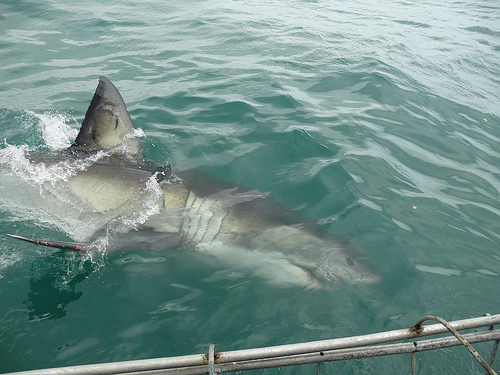


Top predictions:

great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias: 75.05%
tiger shark, Galeocerdo cuvieri: 10.16%
sturgeon: 7.91%
grey whale, gray whale, devilfish, Eschrichtius gibbosus, Eschrichtius robustus: 2.61%
hammerhead, hammerhead shark: 1.49%



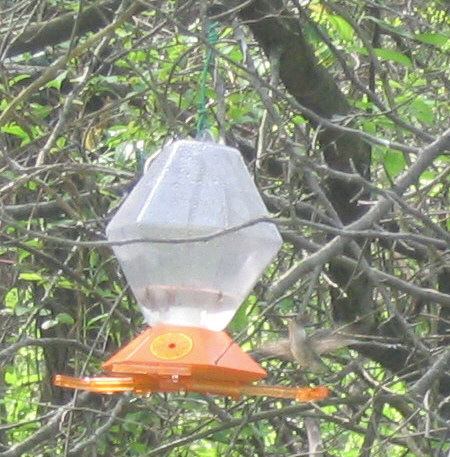


Top predictions:

birdhouse: 56.79%
robin, American robin, Turdus migratorius: 6.99%
washbasin, handbasin, washbowl, lavabo, wash-hand basin: 4.52%
solar dish, solar collector, solar furnace: 2.74%
sundial: 1.97%



In [10]:
labels = list(imagenet_categories.values())
clip_labels = [clip.tokenize(f"a photo of a {label}") for label in labels]
text_inputs = torch.cat(clip_labels).to(device)

with torch.no_grad():
    text_feat = clip_model.encode_text(text_inputs)

def load_and_preprocess_image(image_path, displayed=False):
    try:
        img = Image.open(image_path)
        image = preprocess(img).unsqueeze(0).to(device)
    except Exception as e:
        print(f"Error loading image: {e}")
        return None, None

    if displayed:
        display(img)

    return img, image

def classify_image(img, image, text_feat, model=clip_model, to_print=True):
    with torch.no_grad():
        image_features = model.encode_image(image)
        
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_feat /= text_feat.norm(dim=-1, keepdim=True)
    similarity = (100.0 * image_features @ text_feat.T).softmax(dim=-1)
    values, indices = similarity[0].topk(5)
    
    if to_print:
        print("\nTop predictions:\n")
        for value, index in zip(values, indices):
            print(f"{labels[index]}: {100 * value.item():.2f}%")
        print()
    return labels[indices[0]], values[0].item()

example_images = [
    image_dir+"/n01484850/n01484850_1199.JPEG",
    image_dir+"n01833805/n01833805_6432.JPEG",
]

for image_path in example_images:
    img, image = load_and_preprocess_image(image_path, True)
    if img is not None and image is not None:
        classify_image(img, image, text_feat)

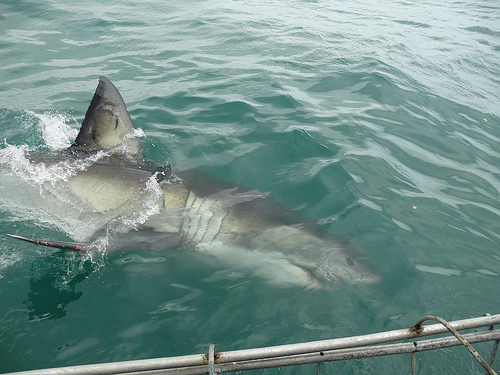

Top predictions:
great white shark: 100.0%
tiger shark: 0.0%
hammerhead: 0.0%
sturgeon: 0.0%
dugong: 0.0%


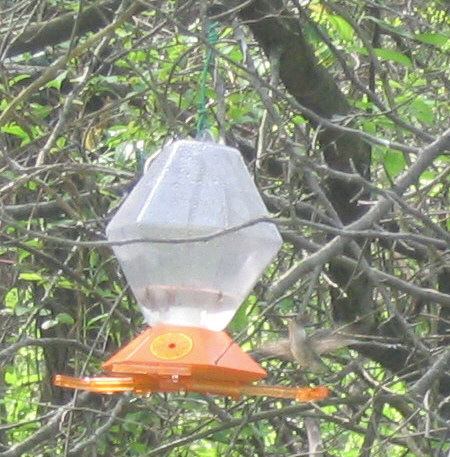

Top predictions:
hummingbird: 76.7%
apiary: 3.7%
indigo bunting: 1.3%
harvester: 1.3%
greenhouse: 1.0%


In [11]:
def load_and_preprocess_image_RESNET50(img_path, displayed=False):
    try:
        img = Image.open(img_path)
        batch = preprocess_resnet(img).unsqueeze(0).to(device)  # Move the input tensor to the GPU
    except Exception as e:
        print(f"Error loading image: {e}")
        return None, None

    if displayed:
        display(img)

    return img, batch

def inference_RESNET50(img, batch, model=torch_model, topk=5, to_print=True):
    model.eval()
    with torch.no_grad():
        prediction = model(batch).squeeze(0).softmax(0)
        
    topk_values, topk_indices = prediction.topk(topk)
    topk_scores = topk_values.tolist()
    topk_class_ids = topk_indices.tolist()
    topk_category_names = [weights.meta["categories"][id] for id in topk_class_ids]
    
    if to_print:
        print("Top predictions:")
        for i in range(topk):
            print(f"{topk_category_names[i]}: {100 * topk_scores[i]:.1f}%")
    return topk_category_names, topk_scores


for img_path in example_images:
    img, batch = load_and_preprocess_image_RESNET50(img_path, True)
    if img is not None and batch is not None:
        inference_RESNET50(img, batch)

## 2.5 FP16

While deep learning has primarily relied on “single” floating precision (32 bits or 4 bytes per parameter), 16-bit floating point numbers are useful for saving on memory. In this question, we will only consider CLIP’s image encoder.

**(i)** Convert the RN50 CLIP image encoder model to fp16. Calculate the (wall-clock) time required to encode an image. Estimate the difference between the fp32 (original) model and the fp16 model. Note, it is common to report the mean over 100 runs and indicate both the mean and standard deviation.

**Answer**: The values are reported below. 

**(ii)** For 5 images (1 per class), recalculate the probabilities using the fp16 model. Are there significant differences between the fp32 and fp16 outputs? Why?

**Answer**: No, there are no significant differences.

**(iii)** Using nvidia-smi or a profiler, note and explain the differences in memory usage for a forward pass between fp32 and fp16 models. If you do not use the profiler, please include some screenshots for the assignment.

**Answer**: The values are reported below. 


Hint: [Understanding GPU Memory](https://pytorch.org/blog/understanding-gpu-memory-1/) may help.

In [12]:
fp16_model, fp16_preprocess = clip.load('RN50', device)
fp16_model.to(torch.float16)

CLIP(
  (visual): ModifiedResNet(
    (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu1): ReLU(inplace=True)
    (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu2): ReLU(inplace=True)
    (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu3): ReLU(inplace=True)
    (avgpool): AvgPool2d(kernel_size=2, stride=2, padding=0)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
     

In [13]:
import time

import numpy as np

def measure_difference(image_path, runs=100):
    img = Image.open(image_path)
    image = preprocess(img).unsqueeze(0).to(device)
    
    # Collecting inference times for the orignal model
    fp32_times = []
    for _ in range(runs):
        start_time = time.time()
        _ = clip_model.encode_image(image)
        end_time = time.time()
        fp32_times.append(end_time - start_time)

    # Collecting inference times for fp16 model
    fp16_times = []
    for _ in range(runs):
        start_time = time.time()
        _ = fp16_model.encode_image(image)
        end_time = time.time()
        fp16_times.append(end_time - start_time)

    # Calculating the mean and standard deviation
    fp32_mean, fp32_std = np.mean(fp32_times), np.std(fp32_times)
    fp16_mean, fp16_std = np.mean(fp16_times), np.std(fp16_times)

    return fp32_mean, fp32_std, fp16_mean, fp16_std

fp32_mean, fp32_std, fp16_mean, fp16_std = measure_difference(example_images[1])
print("Mean inference time (fp32):", fp32_mean)
print("Standard deviation of inference time (fp32):", fp32_std)
print("Mean inference time (fp16):", fp16_mean)
print("Standard deviation of inference time (fp16):", fp16_std)

Mean inference time (fp32): 0.008850574493408203
Standard deviation of inference time (fp32): 0.00098611753654759
Mean inference time (fp16): 0.009911653995513916
Standard deviation of inference time (fp16): 0.0021950173868083294


In [14]:
five_images = [
    '/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01440764/n01440764_10026.JPEG',
    '/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01443537/n01443537_10035.JPEG',
    '/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01494475/n01494475_1001.JPEG',
    '/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01532829/n01532829_10127.JPEG',
    '/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01601694/n01601694_10351.JPEG'
]

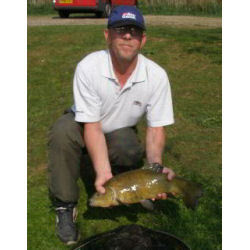


Top predictions:

tench, Tinca tinca: 84.67%
hog, pig, grunter, squealer, Sus scrofa: 5.41%
goldfish, Carassius auratus: 1.84%
Chesapeake Bay retriever: 1.10%
American coot, marsh hen, mud hen, water hen, Fulica americana: 0.67%



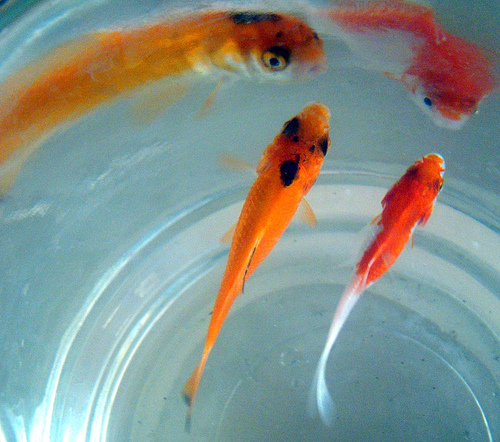


Top predictions:

goldfish, Carassius auratus: 97.61%
tench, Tinca tinca: 0.59%
coho, cohoe, coho salmon, blue jack, silver salmon, Oncorhynchus kisutch: 0.37%
eft: 0.18%
puffer, pufferfish, blowfish, globefish: 0.14%



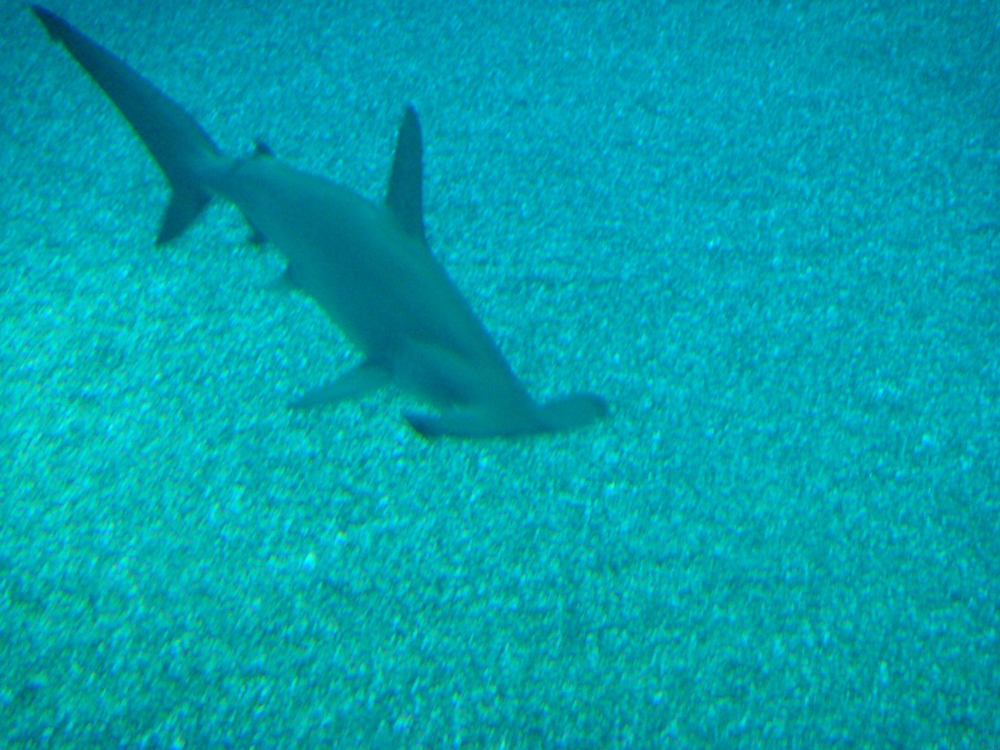


Top predictions:

tiger shark, Galeocerdo cuvieri: 40.94%
hammerhead, hammerhead shark: 39.67%
sturgeon: 10.52%
great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias: 3.63%
snorkel: 0.86%



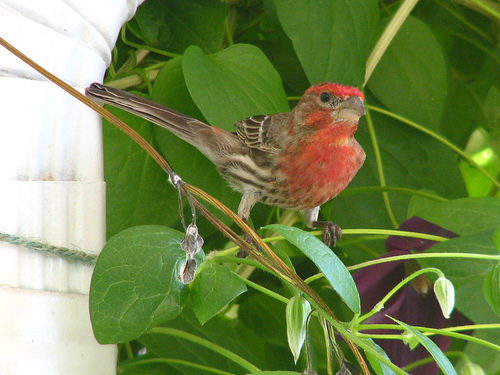


Top predictions:

house finch, linnet, Carpodacus mexicanus: 99.85%
bulbul: 0.05%
robin, American robin, Turdus migratorius: 0.02%
hummingbird: 0.02%
goldfinch, Carduelis carduelis: 0.01%



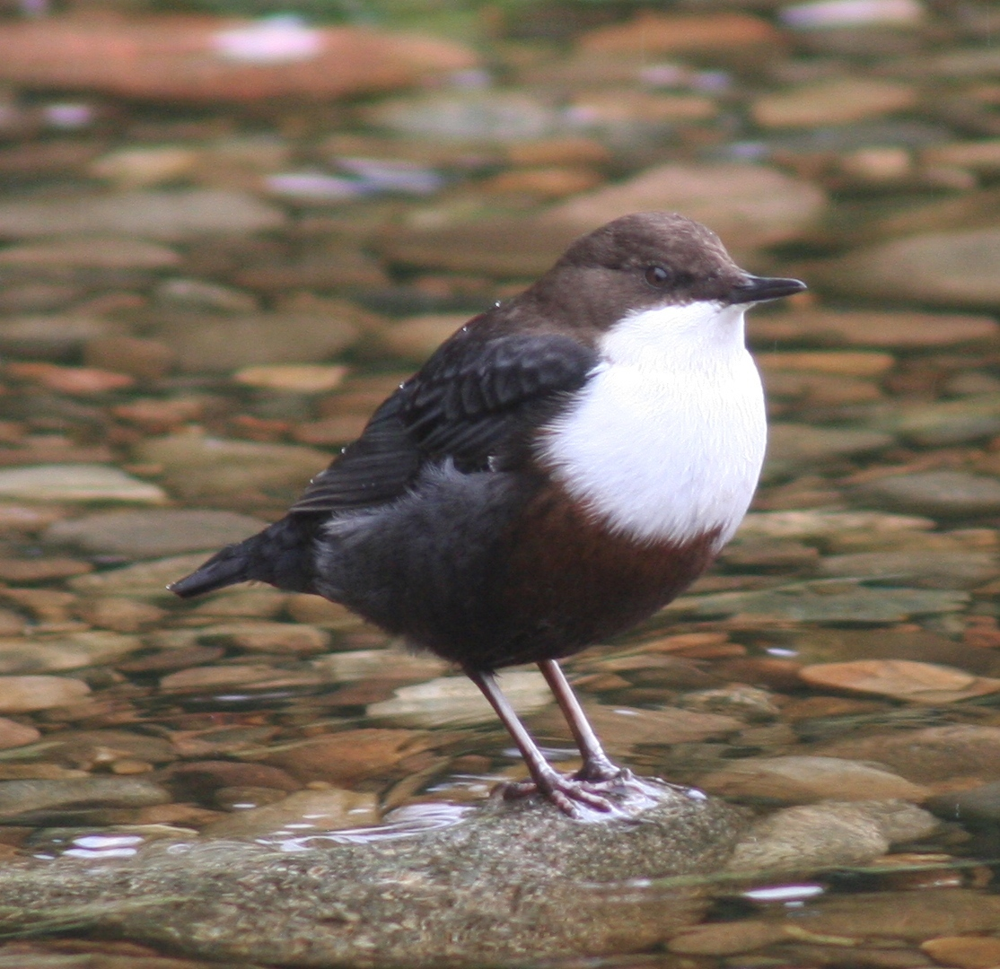


Top predictions:

water ouzel, dipper: 99.51%
red-breasted merganser, Mergus serrator: 0.39%
ruddy turnstone, Arenaria interpres: 0.03%
red-backed sandpiper, dunlin, Erolia alpina: 0.02%
magpie: 0.02%



In [15]:
for image_path in five_images:
    img, image = load_and_preprocess_image(image_path, True)
    if img is not None and image is not None:
        classify_image(img, image, text_feat, model = clip_model)
    

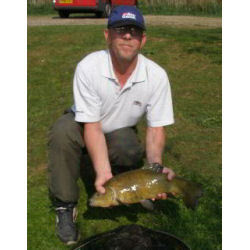


Top predictions:

tench, Tinca tinca: 84.72%
hog, pig, grunter, squealer, Sus scrofa: 5.42%
goldfish, Carassius auratus: 1.81%
Chesapeake Bay retriever: 1.08%
American coot, marsh hen, mud hen, water hen, Fulica americana: 0.67%



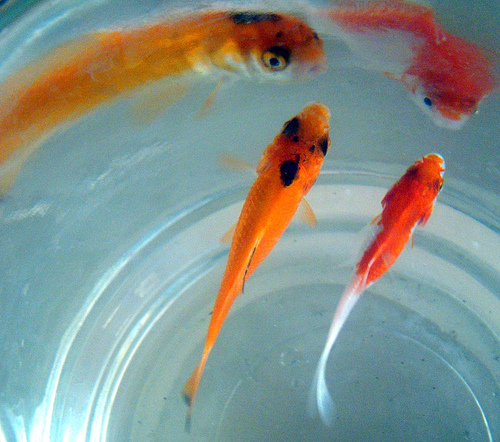


Top predictions:

goldfish, Carassius auratus: 97.61%
tench, Tinca tinca: 0.59%
coho, cohoe, coho salmon, blue jack, silver salmon, Oncorhynchus kisutch: 0.38%
eft: 0.18%
puffer, pufferfish, blowfish, globefish: 0.14%



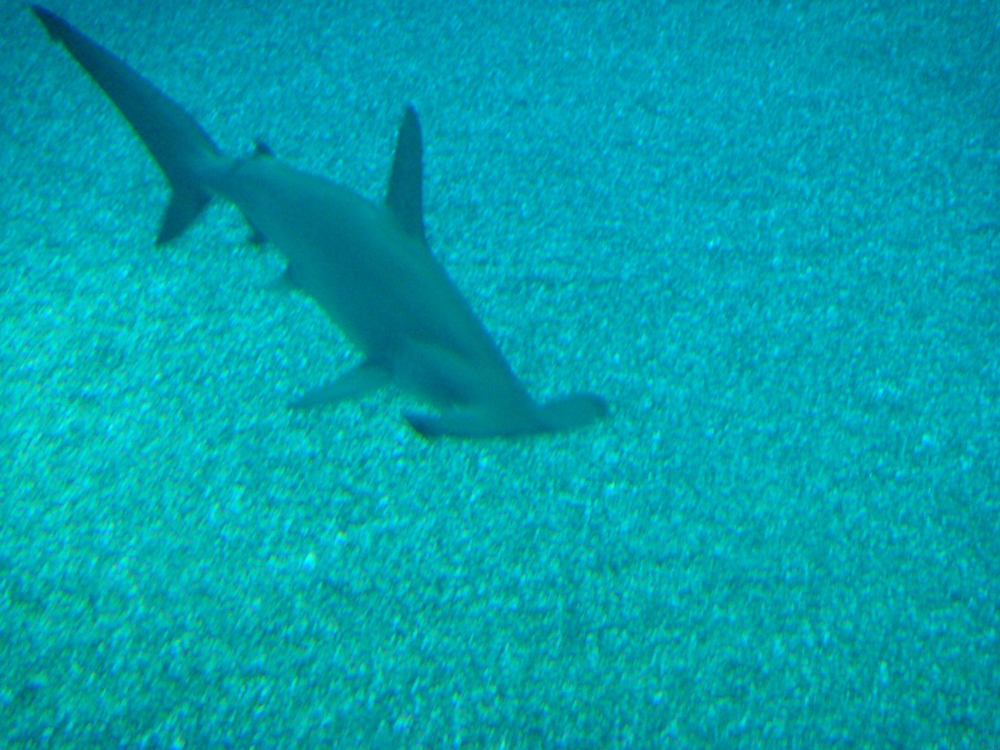


Top predictions:

tiger shark, Galeocerdo cuvieri: 40.77%
hammerhead, hammerhead shark: 39.50%
sturgeon: 10.63%
great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias: 3.73%
snorkel: 0.90%



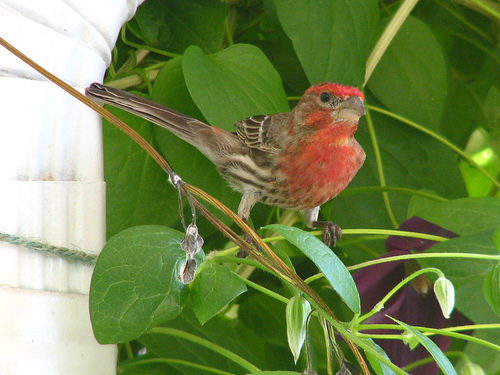


Top predictions:

house finch, linnet, Carpodacus mexicanus: 99.85%
bulbul: 0.05%
robin, American robin, Turdus migratorius: 0.02%
hummingbird: 0.02%
goldfinch, Carduelis carduelis: 0.01%



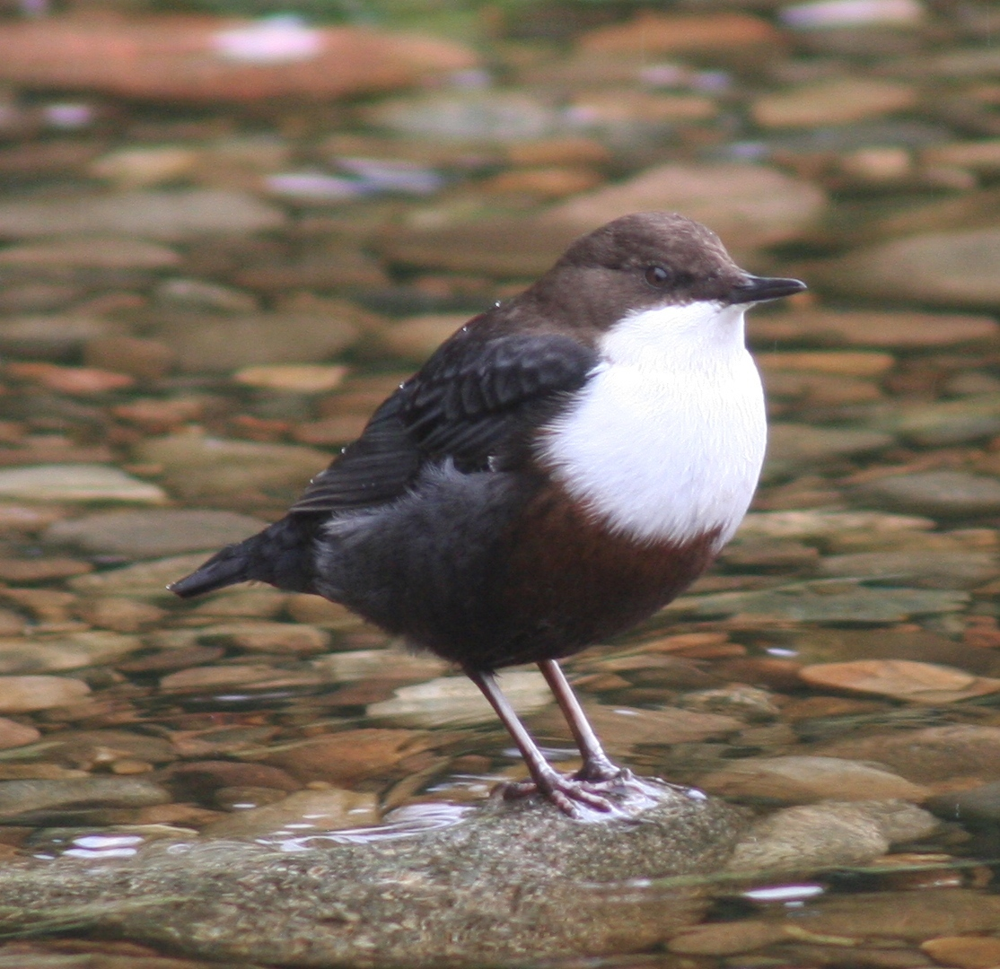


Top predictions:

water ouzel, dipper: 99.51%
red-breasted merganser, Mergus serrator: 0.40%
ruddy turnstone, Arenaria interpres: 0.03%
red-backed sandpiper, dunlin, Erolia alpina: 0.02%
magpie: 0.02%



In [16]:
for image_path in five_images:
    img, image = load_and_preprocess_image(image_path, True)
    if img is not None and image is not None:
        classify_image(img, image, text_feat, model = fp16_model)
    

In [21]:
def measure_memory_usage(model, image):
    torch.cuda.synchronize()  # Ensure that all pending GPU operations are complete
    memory_before = torch.cuda.memory_allocated()
    with torch.no_grad():
        _ = model.encode_image(image)
    torch.cuda.synchronize()  # Ensure that all pending GPU operations are complete
    memory_after = torch.cuda.memory_allocated()
    return memory_after - memory_before

img = Image.open(example_images[0])
image = preprocess(img).unsqueeze(0).to(device)

In [22]:
fp32_memory_usage = measure_memory_usage(clip_model, image)

In [23]:
fp16_memory_usage = measure_memory_usage(fp16_model, image)

In [24]:
print("Memory usage for forward pass (fp32):", fp32_memory_usage / (1024 * 1024))
print("Memory usage for forward pass (fp16):", fp16_memory_usage/ (1024 * 1024))

Memory usage for forward pass (fp32): 0.001953125
Memory usage for forward pass (fp16): 0.001953125
